# Distributional Analysis

Distributional analysis is a term I coined for a very simple yet powerful way of analyzing datasets. It means that you think of the dataset as a distribution within a large multidimensional space, which you then can examine through its marginal statistics in any two-dimensional subspace.

This is my favorite tool for exploratory data analysis&mdash;meaning you don't know what you're looking for just yet, you're simply getting to know the data.  The best way to understand this is through examples. So let's turn our attention to one of my favorite datasets, the global surface drifter dataset. 

Surface instruments record latitude and longitude&mdash;and therefore horizontal velocity&mdash;as well as, sometimes, temperature as they drift following the ocean currents. We're using this classic dataset:

*Lumpkin, Rick; Centurioni, Luca (2019). Global Drifter Program quality-controlled 6-hour interpolated data from ocean surface drifting buoys.  NOAA National Centers for Environmental Information. Dataset. [https://doi.org/10.25921/7ntx-z961](https://doi.org/10.25921/7ntx-z961).*

If you want to run this lab yourself, as opposed to simply viewing it, you'll need to grab the single NetCDF file version of this dataset. That file is currently called `gdp_jul22_ragged_6h.nc` and can be downloaded from [here](https://www.aoml.noaa.gov/ftp/pub/phod/buoydata/gdp_jul22_ragged_6h.nc). 

In [37]:
#Install packages we will need ... set this to true your first time running the notebook
if false
    using Pkg
    Pkg.add("BenchmarkTools")
    Pkg.add("CairoMakie")
    Pkg.add("ColorSchemes")
    Pkg.add("Dates")
    Pkg.add("GeoMakie")
    Pkg.add("Interpolations")
    Pkg.add("LinearAlgebra")
    Pkg.add("NaNStatistics")
    Pkg.add("NetCDF")
    Pkg.add("StatsBase")
    Pkg.add("Test")
    Pkg.add("TickTock")
    Pkg.add("VectorizedStatistics")
end

In [38]:
#load the package  
using BenchmarkTools
using CairoMakie
using ColorSchemes
using Dates
using GeoMakie
using Interpolations
using LinearAlgebra
using NaNStatistics
using NetCDF
using StatsBase: midpoints as mid
using Test
using TickTock
using VectorizedStatistics

import NaNStatistics.nanbinmean


#Please note the function definitions below are expected to eventually become part of a
#maintained and tested package. Check back later. 
#-------------------------------------------------------------------------------------------
#define some functions 
"""
    breaklines(x::AbstractVector,cutoff::Real=10)    

Insert NaNs into `x` at locations where the absolute value of the first central difference
of `x` exceeds the threshold `cutoff`.  Useful for making plots of latitude vs. longitude.
"""
breaklines(x::AbstractVector,cutoff=10::Real)= 
        [[abs(x[n+1]-x[n])<cutoff ? x[n] : NaN for n in 1:length(x)-1];x[end]]
#-------------------------------------------------------------------------------------------
#the remaining functions are all extensions of NaNStatitics to higher-order statistics
"""
    nanbinmean(x, y, xedges)

Ignoring NaNs, calculate the mean value of `y` values that fall into each of 
`length(xedges)-1` equally spaced edges along the `x` axis with bin edges specified by 
`xedges`. The dependent variable `y` mean be real-valued or complex-valued.

The argument `x` should be given as a one-dimensional array (any subtype of AbstractVector)
and `y` as either a 1-d or 2-d array (any subtype of AbstractVecOrMat). If `y` is a 2-d 
array, then each column of `y` will be treated as a separate variable.
"""
function nanbinmean(x::AbstractVecOrMat, y::Union{VecOrMat{ComplexF64},VecOrMat{ComplexF32},VecOrMat{ComplexF16}}, xedges::AbstractRange)
    # complex-valued 1D case
    return nanbinmean(x,real.(y),xedges).+im.*nanbinmean(x,imag.(y),xedges)
end   
"""
    nanbinmean(x, y, z, xedges, yedges)

Ignoring NaNs, calculate the mean values of `z` values that fall into a 2D grid of `x` and `y`
edges with bin edges defined by `xedges` and `yedges`. 

The independent variables `x` and `y`, as well as the dependent variable `z`, are all 
expected as 1D vectors (any subtype of AbstractVector).  

The dependent variable `z` may be real-valued or complex-valued.
"""
function nanbinmean(x::AbstractVector, y::AbstractVector, z::Union{Vector{ComplexF64},Vector{ComplexF32},Vector{ComplexF16}}, xedges::AbstractRange, yedges::AbstractRange)
    # complex-valued 2D case
    return nanbinmean(x,y,real.(z),xedges,yedges).+im.*nanbinmean(x,y,imag.(z),xedges,yedges)
end 
"""
    nanbinvar(x, y, xedges)

Ignoring NaNs, calculate the variance of `y` values that fall into each of 
`length(xedges)-1` equally spaced edges along the `x` axis with bin edges specified by 
`xedges`. The dependent variable `y` mean be real-valued or complex-valued.

The argument `x` should be given as a one-dimensional array (any subtype of AbstractVector)
and `y` as either a 1-d or 2-d array (any subtype of AbstractVecOrMat). If `y` is a 2-d 
array, then each column of `y` will be treated as a separate variable.
"""
function nanbinvar(x::AbstractVecOrMat, y::Union{VecOrMat{ComplexF64},VecOrMat{ComplexF32},VecOrMat{ComplexF16}}, xedges::AbstractRange)
    # complex-valued 1D case
    #take abs to avoid small negative values from numerical noise 
#    return abs.(nanbinmean(x,abs2.(y),xedges).
#        -abs2.(nanbinmean(x,real.(y),xedges).+im.*nanbinmean(x,imag.(y),xedges)))
    return nanbinvar(x,real.(y),xedges)+nanbinvar(x,imag.(y),xedges)
end   
function nanbinvar(x::AbstractVecOrMat, y::AbstractVecOrMat, xedges::AbstractRange)
    # real-valued 1D case
    #take abs to avoid small negative values from numerical noise 
    return abs.(nanbinmean(x,abs2.(y),xedges).-abs2.(nanbinmean(x,y,xedges)))
end   
"""
    nanbinvar(x, y, z, xedges, yedges)

Ignoring NaNs, calculate the variance of `z` values that fall into a 2D grid of `x` and `y`
edges with bin edges defined by `xedges` and `yedges`. 

The independent variables `x` and `y`, as well as the dependent variable `z`, are all 
expected as 1D vectors (any subtype of AbstractVector).  

The dependent variable `z` may be real-valued or complex-valued.
"""
function nanbinvar(x::AbstractVector, y::AbstractVector, z::Union{Vector{ComplexF64},Vector{ComplexF32},Vector{ComplexF16}}, xedges::AbstractRange, yedges::AbstractRange)
    # complex-valued 2D case
    #take abs to avoid small negative values from numerical noise #
#    return abs.(nanbinmean(x,y,abs2.(z),xedges,yedges)
#                .-abs2.(nanbinmean(x,y,real.(z),xedges,yedges).+im.*nanbinmean(x,y,imag.(z),xedges,yedges)))
    return nanbinvar(x,y,real.(z),xedges,yedges)+nanbinvar(x,y,imag.(z),xedges,yedges)
end   
function nanbinvar(x::AbstractVector, y::AbstractVector, z::AbstractVecOrMat, xedges::AbstractRange, yedges::AbstractRange)
    # real-valued 2D case
    #take abs to avoid small negative values from numerical noise 
    return abs.(nanbinmean(x,y,abs2.(z),xedges,yedges).-abs2.(nanbinmean(x,y,z,xedges,yedges)))
end   
#-------------------------------------------------------------------------------------------
"""
    nanedgeskew(x, y, xedges)

Ignoring NaNs, calculate the skewness of `y` values that fall into each of 
`length(xedges)-1` equally spaced edges along the `x` axis with bin edges specified by 
`xedges`. The dependent variable `y` mean be real-valued or complex-valued.

The argument `x` should be given as a one-dimensional array (any subtype of AbstractVector) 
and `y` as either a 1-d or 2-d array (any subtype of AbstractVecOrMat). If `y` is a 2-d 
array, then each column of `y` will be treated as a separate variable.
"""
function nanbinskew(x::AbstractVecOrMat, y::AbstractVecOrMat, xedges::AbstractRange, yedges::AbstractRange)
    #let μ_n and ν_n be the nth moment and central moment, respectively.
    #one may readily show ν_3 = μ_3-3μν_2-μ^3        

    mu = nanbinmean(x,y,xedges)
    var = nanbinvar(x,y,xedges)
    mu3 = nanbinmean(x,y.^3,xedges)
    nu3 = mu3.-3mu.*var.-mu.^3
    skew = nu3 ./ var.^(3/2)    
    return skew
end 
"""
    nanedgeskew(x, y, z, xedges, yedges)

Ignoring NaNs, calculate the skewness of `z` values that fall into a 2D grid of `x` and `y` 
edges with bin edges defined by `xedges` and `yedges`. 

The independent variables `x` and `y`, as well as the dependent variable `z`, are all 
expected as 1D vectors (any subtype of AbstractVector).  

The dependent variable `z` may be real-valued or complex-valued.
"""
function nanbinskew(x::AbstractVecOrMat, y::AbstractVecOrMat, z::AbstractVecOrMat, xedges::AbstractRange, yedges::AbstractRange)
    #let μ_n and ν_n be the nth moment and central moment, respectively.
    #one may readily show ν_3 = μ_3-3μν_2-μ^3        

    mu = nanbinmean(x,y,z,xedges,yedges)
    var = nanbinvar(x,y,z,xedges,yedges)
    mu3 = nanbinmean(x,y,z.^3,xedges,yedges)
    nu3 = mu3.-3mu.*var.-mu.^3
    skew = nu3 ./ var.^(3/2)    
    return skew
end 
#-------------------------------------------------------------------------------------------
"""
    nanbinkurt(x, y, xedges)

Ignoring NaNs, calculate the excess kurtosis of `y` values that fall into each of 
`length(xedges)-1` equally spaced edges along the `x` axis with bin edges specified by 
`xedges`. The dependent variable `y` mean be real-valued or complex-valued.

The argument `x` should be given as a one-dimensional array (any subtype of AbstractVector) 
and `y` as either a 1-d or 2-d array (any subtype of AbstractVecOrMat). If `y` is a 2-d 
array, then each column of `y` will be treated as a separate variable.
"""
function nanbinkurt(x::AbstractVecOrMat, y::AbstractVecOrMat, xedges::AbstractRange)
    #let μ_n and ν_n be the nth moment and central moment, respectively.
    #one may readily show ν_4 = μ_4-4μμ_3+6μ^2ν_2+3μ^4        

    mu = nanbinmean(x,y,xedges)
    var = nanbinvar(x,y,xedges)
    mu3 = nanbinmean(x,y.^3,xedges)
    mu4 = nanbinmean(x,y.^4,xedges)
    nu4 = mu4.-4mu.*mu3.+6(mu.^2).*var.+3mu.^4
    kurt = nu4 ./ var.^2 .- 3
    return kurt
end   
"""
    nanbinkurt(x, y, z, xedges, yedges)

Ignoring NaNs, calculate the excess kurtosis of `z` values that fall into a 2D grid of `x` 
and `y` edges with bin edges defined by `xedges` and `yedges`. 

The independent variables `x` and `y`, as well as the dependent variable `z`, are all 
expected as 1D vectors (any subtype of AbstractVector).  

The dependent variable `z` may be real-valued or complex-valued.
"""
function nanbinkurt(x::AbstractVecOrMat, y::AbstractVecOrMat, z::AbstractVecOrMat, xedges::AbstractRange, yedges::AbstractRange)
    #let μ_n and ν_n be the nth moment and central moment, respectively.
    #one may readily show ν_4 = μ_4-4μμ_3+6μ^2ν_2+3μ^4        

    mu = nanbinmean(x,y,z,xedges,yedges)
    var = nanbinvar(x,y,z,xedges,yedges)
    mu3 = nanbinmean(x,y,z.^3,xedges,yedges)
    mu4 = nanbinmean(x,y,z.^4,xedges,yedges)
    nu4 = mu4.-4mu.*mu3.+6(mu.^2).*var.+3mu.^4
    kurt = nu4 ./ var.^2 .- 3 
    return kurt
end;

In [39]:
#load in hourly drifter dataset

#using TickTock for convenience to time this script even though the documentation
#explicitly tells me not to, see https://docs.juliahub.com/TickTock/NkTNm/1.0.0/
tick()

#Note that for expediency, we're going to leave the input variables as Float32s.
#This really helps to reduce memory usage and speed up computation times. 
#For some high-precision computations, you may wish to convert these to Float64s.

datadir = "/Users/lilly/Desktop/Dropbox/NetCDf/"  #your path to the data directory
filename = datadir * "gdp_jul22_ragged_6h.nc"
#filename = datadir * "gdp_v2.00.nc"
#ncinfo(filename)
rowsize=ncread(filename,"rowsize")     #length of each trajectory 
traj_start=cumsum(rowsize).-rowsize.+1 #start of each trajectory 
traj_end=cumsum(rowsize)               #end of each trajectory 
#lat=ncread(filename,"latitude")
#lon=ncread(filename,"longitude")
lat=ncread(filename,"lat")
lon=ncread(filename,"lon")
u=100ncread(filename,"ve") #convert to cm/s
v=100ncread(filename,"vn");#convert to cm/s
sst=ncread(filename,"temp");
#convert seconds since 1970-01-01 00:00:00 (unix time) to a datetime object
tim=unix2datetime.(ncread(filename,"time"));
#sst1=ncread(filename,"sst1").-273.15  #convert to C from Kelvin
#sst2=ncread(filename,"sst2").-273.15; #convert to C from Kelvin

#for converting to Float64s instead
#lat=Float64.(ncread(filename,"latitude"))
#lon=Float64.(ncread(filename,"longitude"))
#u=Float64.(100ncread(filename,"ve")) #convert to cm/s
#v=Float64.(100ncread(filename,"vn"));#convert to cm/s 
#sst1=Float64.(ncread(filename,"sst1").-273.15)  #convert to C from Kelvin
#sst2=Float64.(ncread(filename,"sst2").-273.15); #convert to C from Kelvin

┌ Info:  started timer at: 2023-06-21T21:24:48.007
└ @ TickTock /Users/lilly/.julia/packages/TickTock/fGILW/src/TickTock.jl:54


44544647-element Vector{DateTime}:
 1993-03-07T18:00:00
 1993-03-08T00:00:00
 1993-03-08T06:00:00
 1993-03-08T12:00:00
 1993-03-08T18:00:00
 1993-03-09T00:00:00
 1993-03-09T06:00:00
 1993-03-09T12:00:00
 1993-03-09T18:00:00
 1993-03-10T00:00:00
 ⋮
 2022-07-03T06:00:00
 2022-07-03T12:00:00
 2022-07-03T18:00:00
 2022-07-04T00:00:00
 2022-07-04T06:00:00
 2022-07-04T12:00:00
 2022-07-04T18:00:00
 2022-07-05T00:00:00
 2022-07-05T06:00:00

In [40]:
#create a Makie theme for plotting global maps 
maptheme = Theme(
    fontsize = 24,
    Heatmap = (colormap=Reverse(:Spectral_11),),
    #Some other favorite colormaps: nuuk,lajolla, batlow, vik, broc, thermal, tempo, curl
    #seehttps://docs.juliahub.com/MakieGallery/Ql23q/0.2.17/generated/colors.html
    Colorbar = (height = Relative(0.7),),

    #Note that themeing does not seem to be working on most aspects of GeoAxis, which
    #appears to override a number of Makie properties.  Otherwise, we could also set the 
    #following theme properties as well.

    #Figure = (resolution = (1600, 700), backgroundcolor = :transparent),
    #Axis = (limits=(-179.9,179.9,-80,80), aspect = 2),
 )
set_theme!(maptheme)

#set some other default figure properties 
dest = "+proj=eqc" #Map projection using "+proj=eqc", equidistant cylindrical (Plate Carrée)
resolution = (2000, 1000) 
backgroundcolor = :transparent
limits = (-179.9,179.9,-80, 80)
color = :lightgray  #color for continents

#choose the bin edges for our 2D griddign 
lonedges=(-180:1/4:180)
latedges=(-80:1/4:80);

## Exploring the Drifter Dataset

Let's make a basic plot of the drifter dataset.  First we will loop over all of the trajectories in order to plot each trajectory with a different color.

In [41]:
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
for n = 1:length(traj_start)
    index=traj_start[n]:10:traj_end[n]
    lines!(breaklines(lon[index]),lat[index])#decimate by every 10th point for speed
end
poly!(ax, GeoMakie.land();color)
ax.title="The Global Surface Drifter Dataset";

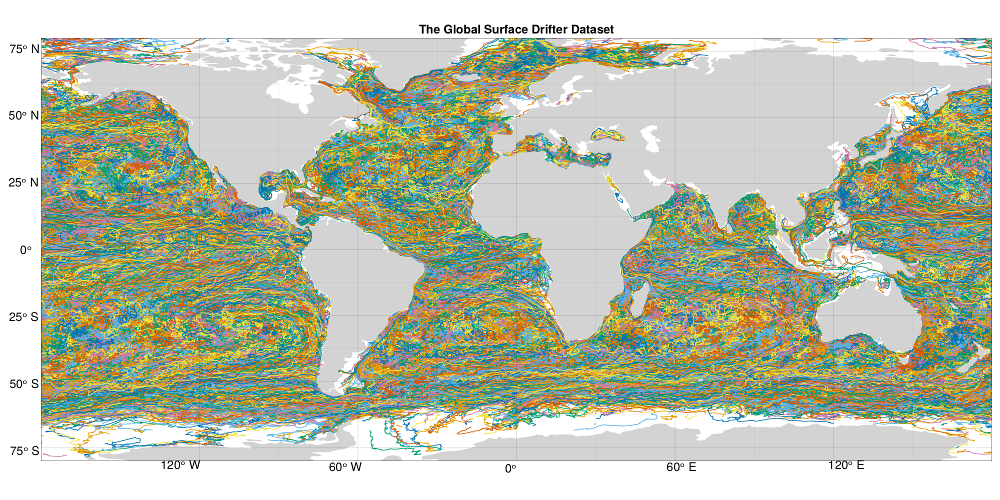

In [42]:
display(f);

## Two-Dimensional Histograms

However, this doesn't tell us much quantitatively. To go further we're going to start exploring this dataset as a distribution.  The first step is to plot the two dimensional histogram of observation locations in latitude&ndash;longitude space.

In [43]:
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
mat = histcounts(lon,lat,lonedges,latedges)
mat = [m!=0 ? m : NaN for m in mat] #replace zeros with NaNs
#note that makie is expecting x along rows, so we need to transpose
hm=heatmap!(mid(lonedges),mid(latedges),log10.(mat)',colorrange=(1,2.75),nan_color=:white)
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Log10 Number of Observations")
ax.title="Distribution of Six-Hourly Data Points";

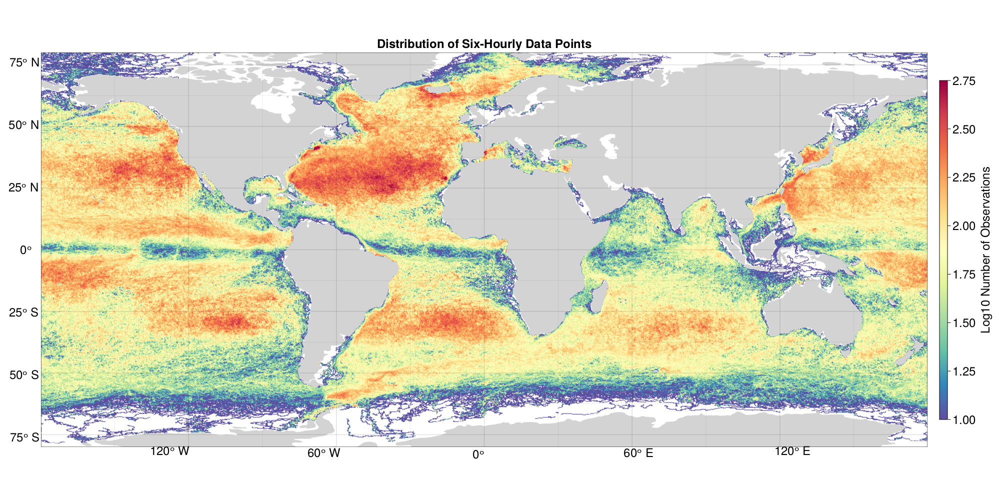

In [44]:
display(f);

We see that the observation density is high in the central gyres, particularly in the North Atlantic, and is low in the Arctic, Antarctic, upwelling zones, and shallow seas.  

Let's take a look now at the distribution in time.  For this, it will be useful to use latitude as one axis and time as the other. 

In [45]:
#distribution of data points over latitude and time

#create a two-panel for latitude distributions
lattwopaneltheme=Theme(
    fontsize = 18,
    Heatmap = (colormap=Reverse(:Spectral_11),),
    Colorbar = (vertical = false,  flipaxis = false,
              width = Relative(0.8), height = Relative(0.5)),
    Axis = (grid= :off,)
)

set_theme!(lattwopaneltheme);f = Figure(;resolution = (1600, 900),backgroundcolor)

ax = Axis(f[1, 1],xticks=(1975:5:2022))
xedges=(1978:2022)
mat = histcounts(year.(tim),lat,xedges,latedges)
mat = [m!=0 ? m : NaN for m in mat] #replace zeros with NaNs
hm=heatmap!(mid(xedges),mid(latedges),log10.(mat)')
ax.title="Data Distribution Over Year and Latitude";
ax.title="Year";ax.ylabel="Latitude"
Colorbar(f[2,1],hm;label = "Log10 Number of Data Points")

ax = Axis(f[1, 2],xticks=(0:30:360),yticklabelsvisible=false)
xedges=(0:10:365)
mat = histcounts(dayofyear.(tim),lat,xedges,latedges)
mat = [m!=0 ? m : NaN for m in mat] #replace zeros with NaNs
hm=heatmap!(mid(xedges),mid(latedges),log10.(mat)')
ax.title="Data Distribution Over Yearday and Latitude";
ax.xlabel="Yearday"
Colorbar(f[2,2],hm;label = "Log10 Number of Data Points")

colgap!(f.layout,10);rowsize!(f.layout,2,Relative(0.08));

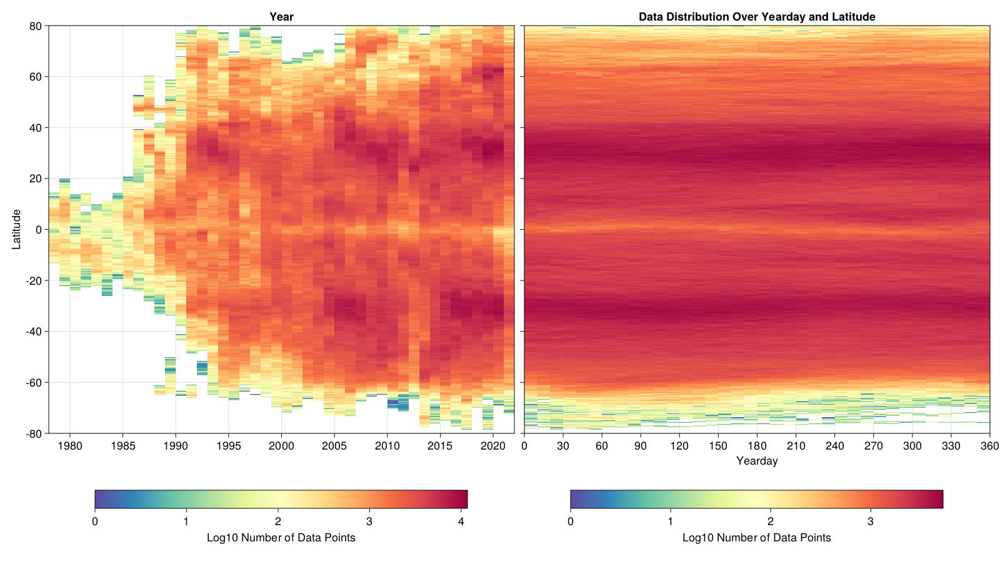

In [46]:
display(f); 

We see that there is much interannual variability of the data distribution, but little annual variability.  This is  good news, because it means aliasing of the annual cycle, which we expect to be stronger than the interannual variability in this case, won't impact the mean statistics. 

## Two-Dimensional Means and Standard Deviations

It's very useful to also examine basic statistics as a function of two parameters.  The most obvious choices for the axes of such two-dimensional statistics in this case would again be latitude and longitude. 

In [47]:
#Now let's look at two-dimensional statitistics, starting with the speed of the mean flow
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
mat=abs.(nanbinmean(lon,lat,u.+im.*v,lonedges,latedges))
hm=heatmap!(mid(lonedges),mid(latedges),mat',colorrange=(0,80))
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Speed (cm/s)")
ax.title="Speed of Mean Surface Currents";

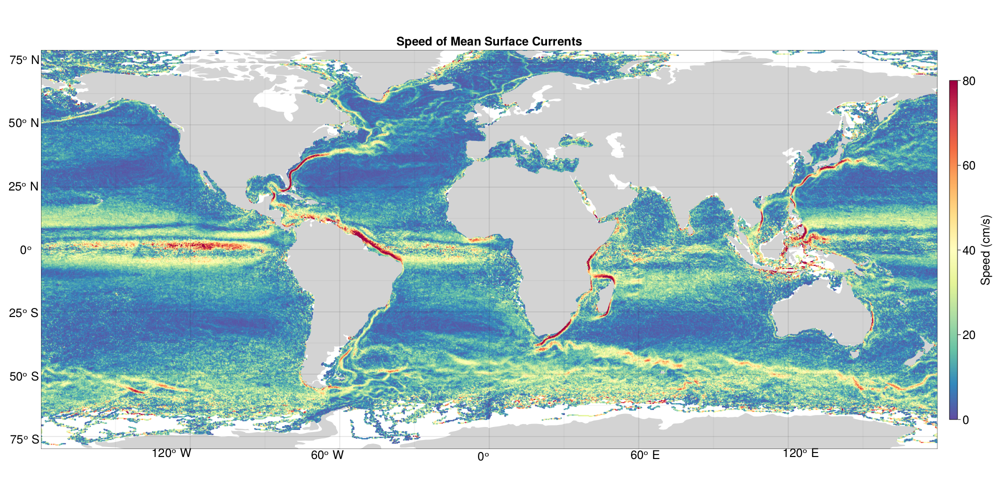

In [48]:
display(f);

We see the major current systems as thin ribbons: the Gulf Stream, the Kuroshio, the Brazil Current, the Agulhas Current, the equatorial current system, and so forth. 

A slightly different quantity is the mean of the current speed, rather than the speed or magnitude of the mean flow. 

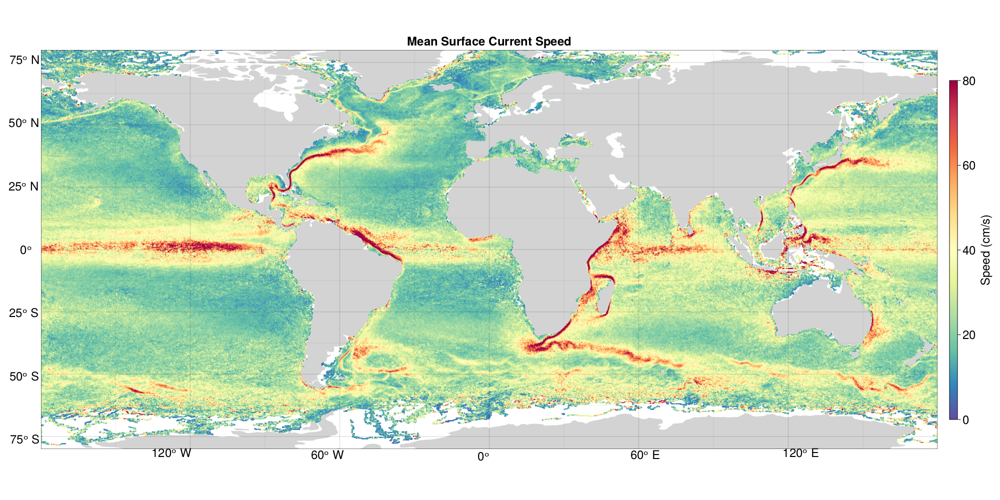

In [73]:
#The mean of the speed
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
mat=nanbinmean(lon,lat,abs.(u.+im.*v),lonedges,latedges)
hm=heatmap!(mid(lonedges),mid(latedges),mat',colorrange=(0,80))
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Speed (cm/s)")
ax.title="Mean Surface Current Speed";
display(f);

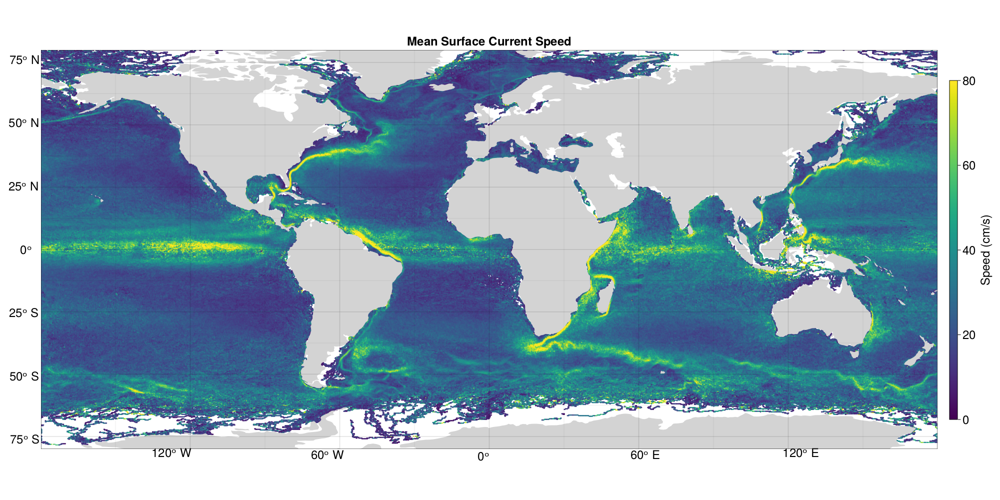

In [50]:
display(f);

The mean speed paints the currents as slightly broader ribbons, because now the magnitude is not decreased by the variability of a current's direction.  

A measure of the variability is the velocity standard deviation, which we look at next. 

In [51]:
#Standard deviation 
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
mat=sqrt.(nanbinvar(lon,lat,u.+im.*v,lonedges,latedges))
hm=heatmap!(mid(lonedges),mid(latedges),mat',colorrange=(0,80))
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Standard Deviation (cm/s)")
ax.title="Standard Deviation of Surface Currents";

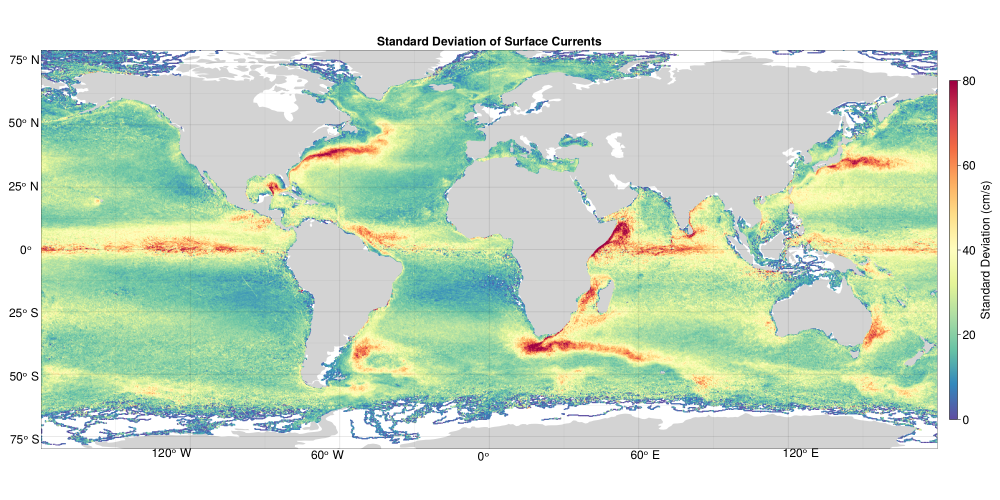

In [52]:
display(f);

To see how these compare we can examine the coefficient of variation, defined as the ratio of the standard devation to the mean.  This is a nondimensional quantity showing the *relative* magnitude of variability. The larger the coefficient of variation, the larger typical deviations from the mean are with respect to the mean itself.

Note that the coefficient of variation is only meaningful when there is a true zero, that is for quantities like speed, height, amount of precipitation or radiation, etc.  Such data is called *ratio data* in statistics.  One would not use it for, say, temperature, because while 0 K is well defined, it is not a meaningful reference zero for typical planetary processes.

For plotting the coefficient of variation, it is useful to take the log, as this has the nice property that log(1/a)=-log(a). 

In [53]:
#coefficient of variation
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
numer=sqrt.(nanbinvar(lon,lat,u.+im.*v,lonedges,latedges))
denom=abs.(nanbinmean(lon,lat,u.+im.*v,lonedges,latedges))
hm=heatmap!(mid(lonedges),mid(latedges),log2.(numer./denom)',colorrange=(-3,3),colormap=Reverse(:BrBG))
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Log2 Coefficent of Variation σ/|μ| (nondimensional)",ticks=(-3:3))
ax.title="Coefficent of Variation σ/|μ|";

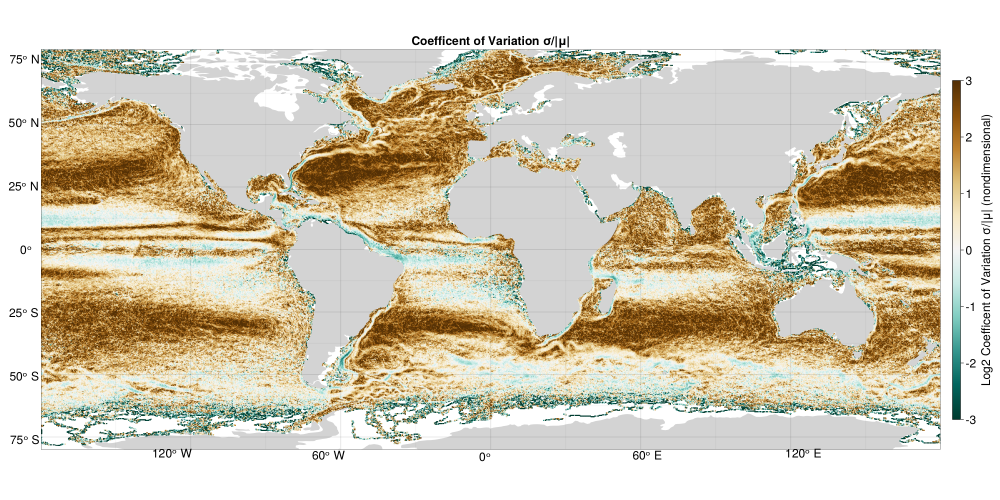

In [54]:
display(f);

Let's change now to another quantity, the sea surface temperature.  

However, note that the number of data points involved for which the temperature is measured is considerably smaller than the total.  Thus, if we were going to look further at this, we would also want to redo the data distributions we presented earlier, showing only the number of data points for which sea surface temperature is not NaN.

For expediency, we will skip this step and go straight to the two-dimensional statistics. 

In [55]:
#mean sea surface temperature
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
mat=nanbinmean(lon,lat,sst,lonedges,latedges)
hm=heatmap!(mid(lonedges),mid(latedges),mat',colorrange=(0,31))
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Temperature (ºC)")
ax.title="Mean Sea Surface Temperature";

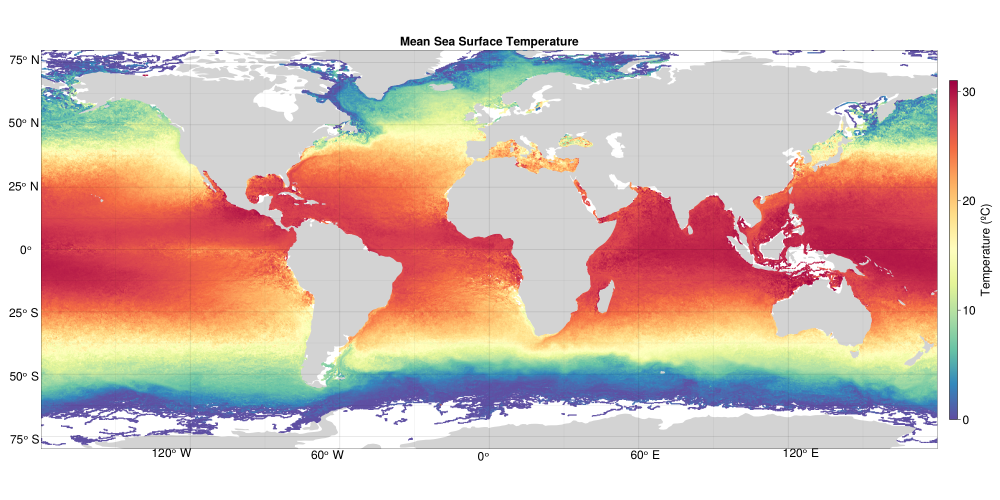

In [56]:
display(f);

Note the multi-scale structure present here: global, regional, and small-scale or mesoscale.  

The large-scale temperature gradient is dominating the picture, obscuring the other variability.  To account for this, we can subtract the longitudinally-averaged temperature at each latitude.  This forms the temperature deviation from the zonal average.    

In [57]:
#temperature deviation from zonal average
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
ax = GeoAxis(f[1, 1];dest,limits)
hm=heatmap!(mid(lonedges),mid(latedges),mat'-repeat(nanmean(mat;dims=2),1,size(mat,2))',colorrange=(-7,7))
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Temperature (ºC)",ticks=(-6:2:6))
ax.title="Temperature Deviation from Zonal Average";

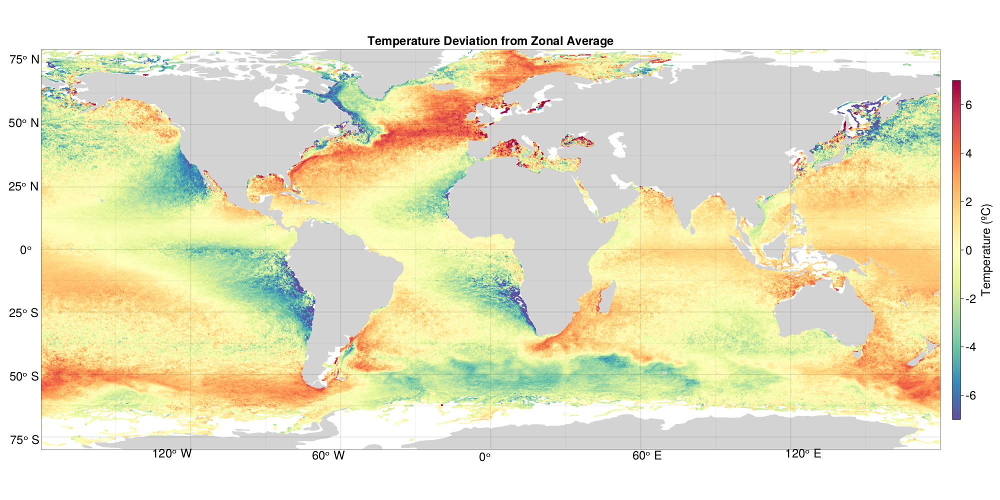

In [58]:
display(f);

We see that subtracting the zonal mean reveals smaller-scale structures. We now see more clearly that generally speaking, it's colder on the eastern side than on the western sides of ocean basins. 

Finally we look at the sea surface temperature standard deviation.

In [59]:
#sea surface temperature standard deviation
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)
mat=sqrt.(nanbinvar(lon,lat,sst,lonedges,latedges))
ax = GeoAxis(f[1, 1];dest,limits)
hm=heatmap!(mid(lonedges),mid(latedges),mat',colorrange=(0,6))
poly!(ax, GeoMakie.land();color)
Colorbar(f[1,2],hm;label = "Temperature Standard Deviation (ºC)")
ax.title="Sea Surface Temperature Standard Deviation";

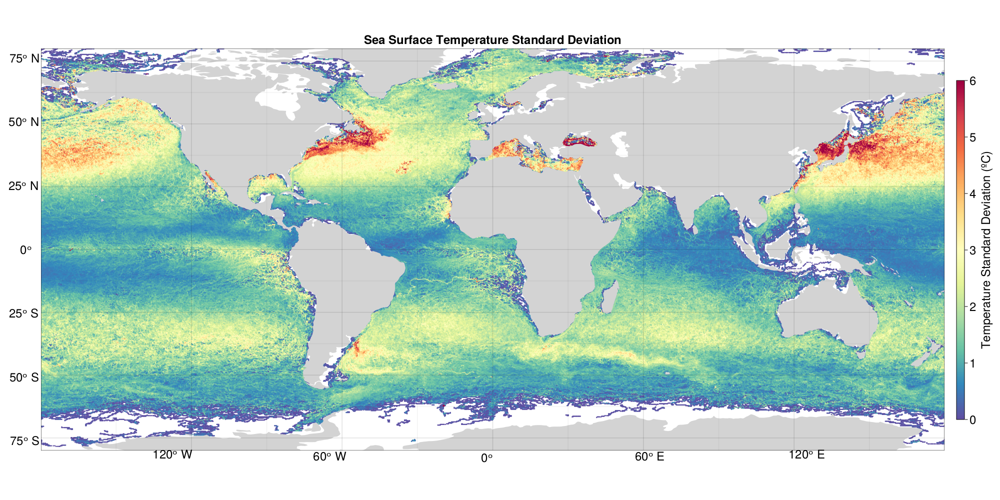

In [60]:
display(f);

This shows a remarkably strong asymmetry between the northern and southern hemispheres.  

Regions of the highest mean sea surface temperature&mdash;such as the tropical warm pools&mdash;and also regions of the lowest mean sea surface temperature&mdash;the polar regions&mdash; are both regions of notably low temperature variability.

The regions of highest tempertature variability are the eddying or high velocity variance regions of the northern subtropical western boundary currents, specifically the Gulf Stream and Kuroshio, as well as relatively shallow seas such as the Sea of Okhotsk and the Black Sea.

## Distributions and Statistics in Non-Spatial Dimensions

For a while now we been looking at the statistics in latitude&ndash;longitude space.  However, there are many other perspectives from which we could view this data.  Let's start by returning to temperature and trying another way to examine the large-scale gradient. 

In [61]:
#mean sea surface temperature, with latitudinal profile
set_theme!(maptheme);f = Figure(;resolution,backgroundcolor)

ax = Axis(f[1, 1];limits,xticks=(-120:60:120),yticks=(-75:25:75),aspect=2)
mat=nanbinmean(lon,lat,sst,lonedges,latedges)
hm=heatmap!(mid(lonedges),mid(latedges),mat',colorrange=(0,31))
poly!(ax, GeoMakie.land();color)
ax.title="Mean Sea Surface Temperature";
Colorbar(f[2,1],hm;label = "Temperature (ºC)",vertical=false,
        width = Relative(0.8), height = Relative(0.5), flipaxis = false)

#I don't have a good way to sync these y-axes at the moment, sorry. Using Axis not GeoAxis 
#to make the alignment of the y-axes better
ax = Axis(f[1, 2];height = Relative(1),yticklabelsvisible=false)
xedges=(-3:.1:32);yedges=latedges
mato=nanbinmean(lon,lat,sst,lonedges,latedges)
mat=histcounts(vec(mato),vec(mid(latedges).+0 .*mato),xedges,yedges)
hm=heatmap!(mid(xedges),mid(yedges),log10.(mat)',colorrange=(0,1.85),lowclip=:transparent)
ax.xlabel="Mean SST at Each Gridpoint (ºC)"
ax.title="SST Latitudinal Profile";
Colorbar(f[2,2],hm;label = "Log10 Number of Grid Points",vertical=false,
        width = Relative(0.8), height = Relative(0.5), flipaxis = false)

colsize!(f.layout,2,Relative(0.2))
rowsize!(f.layout,2,Relative(0.08))

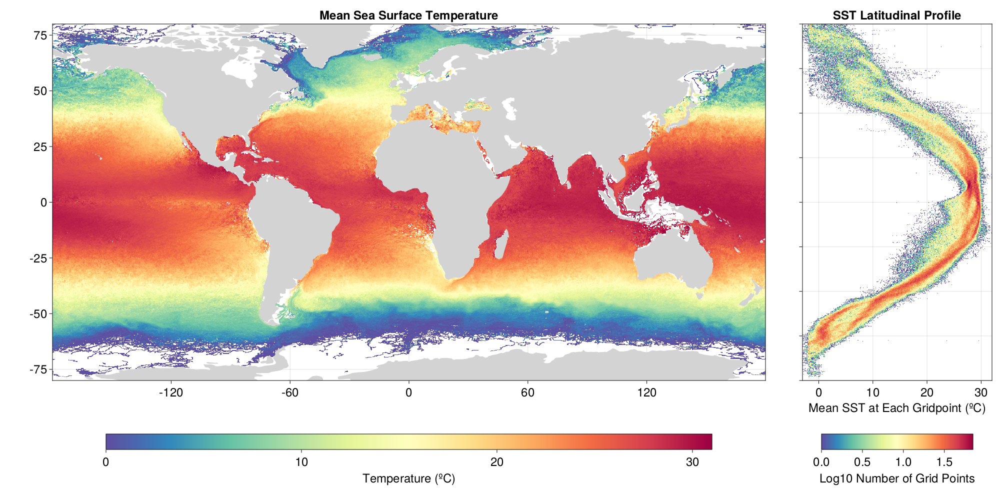

In [62]:
display(f);

The right-hand panel now has latitude as its y-axis, but its x-axis is the mean temperature at each gridpoint.  We can think of this as rotating the data distribution: rather than by looking at it from the "top", with latitidue and longitude as the axes and the temperature flattened, we turn it to the side such that longitude disappears, but temperature appears as an explicit dimension. 

The right-hand panel now summarizes the distribution along the longitude axis from the left-hand panel.  The different "stripes" in the latitude&ndash;temperature distribution likely represent the different ocean basins, a hypothesis one could readily verify. 

Let's continue with this approach and look at latitudinal profiles of number of different quantities.  

In [63]:
#latitudinal profiles 

#theme for multiple latitudinal profiles
profiletheme=Theme(
    fontsize = 16,
    Heatmap = (colormap=Reverse(:Spectral_11),lowclip = :transparent),
    Colorbar = (vertical = false, flipaxis = false, width = Relative(0.8), height = Relative(0.4)),
    Figure = (backgroundcolor = :transparent,)
)

set_theme!(profiletheme);f = Figure(;resolution=(1600,900),backgroundcolor)
yedges=latedges

ax = Axis(f[1, 1])
xedges=(-3:.1:32)
mato=nanbinmean(lon,lat,sst,lonedges,latedges)
mat=histcounts(vec(mato),vec(mid(latedges).+0 .*mato),xedges,yedges)
hm=heatmap!(mid(xedges),mid(yedges),log10.(mat)',colorrange=(0,1.85))
ax.title="Mean SST at Each Gridpoint"
ax.xlabel="Temperature (ºC)"
ax.ylabel="Latitude"
Colorbar(f[2,1],hm;label = "Log10 Number of Grid Points")

ax = Axis(f[1, 2]) 
xedges=(0:.025:6.99)
mato=sqrt.(nanbinvar(lon,lat,sst,lonedges,latedges))
mat=histcounts(vec(mato),vec(mid(latedges).+0 .*mato),xedges,yedges)
hm=heatmap!(mid(xedges),mid(yedges),log10.(mat)',colorrange=(0,1.85))
ax.yticklabelsvisible=false
ax.title="Temperature Standard Deviation at Each Gridpoint"
ax.xlabel="Temperature Standard Deviation (ºC)"
Colorbar(f[2,2],hm;label = "Log10 Number of Grid Points")

ax = Axis(f[1, 3],xticks=(0:10:50)) 
xedges=(0:1/3:59.99)
mato=abs.(nanbinmean(lon,lat,u.+im.*v,lonedges,latedges))
mat=histcounts(vec(mato),vec(mid(latedges).+0 .*mato),xedges,yedges)
hm=heatmap!(mid(xedges),mid(yedges),log10.(mat)',colorrange=(0,1.85))
ax.yticklabelsvisible=false
ax.title="Speed of Mean Flow at Each Gridpoint"
ax.xlabel="Velocity Magnitude (cm/s)"
Colorbar(f[2,3],hm;label = "Log10 Number of Grid Points")

ax = Axis(f[1, 4],xticks=(0:10:50)) 
xedges=(0:1/3:59.99)
mato=sqrt.(nanbinvar(lon,lat,u.+im.*v,lonedges,latedges))
mat=histcounts(vec(mato),vec(mid(latedges).+0 .*mato),xedges,yedges)
hm=heatmap!(mid(xedges),mid(yedges),log10.(mat)',colorrange=(0,1.85))
ax.yticklabelsvisible=false
ax.title="Velocity Standard Devation at Each Gridpoint"
ax.xlabel="Velocity Standard Deviation (cm/s)"
Colorbar(f[2,4],hm;label = "Log10 Number of Grid Points")

rowsize!(f.layout,2,Relative(0.08))
colgap!(f.layout,10);

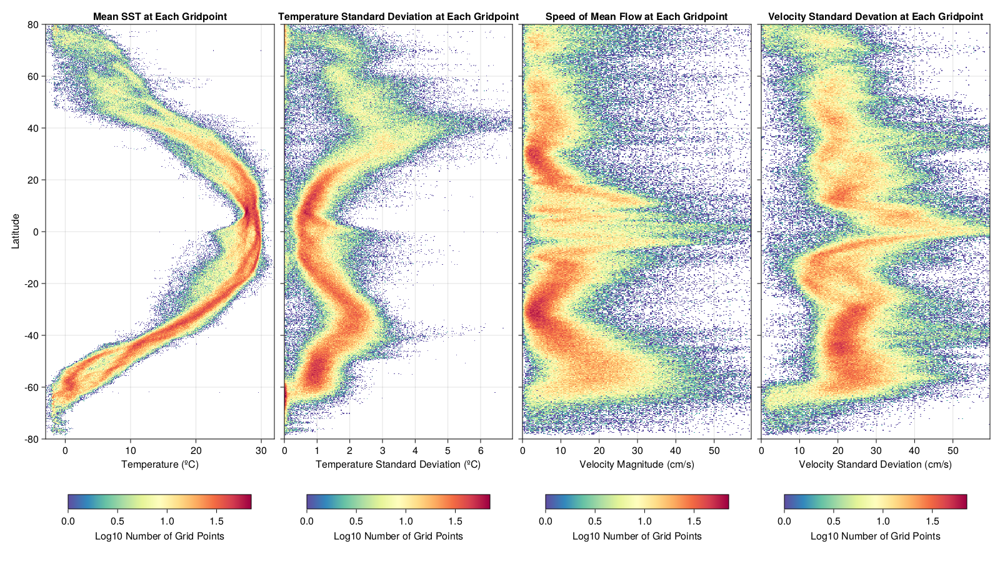

In [64]:
display(f);

These show the latitude distributions corresonding to latitude&ndash;longitude plots we made earlier. 

One pattern which jumps out is that the temperature standard deviation is lowest at very low (equatorial) latitudes and very high negative latitudes, that is, where the temperature is warmest or coldest.

We can also examine the joint structure of these variables by taking the mean value of a third quantity.  Some of these are interesting and some are less interesting.  An interesting one is the joint structure of mean temperature and current speed. 

In [65]:
#joint structure of temperature and velocity 
set_theme!(profiletheme);f = Figure(;resolution=(1600,900),backgroundcolor)
yedges=latedges

ax = Axis(f[1, 1])
xedges=(-3:.1:32)
mato=nanbinmean(lon,lat,sst,lonedges,latedges)
mat=histcounts(vec(mato),vec(mid(latedges).+0 .*mato),xedges,yedges)
hm=heatmap!(mid(xedges),mid(yedges),log10.(mat)',colorrange=(0,1.85))
ax.title="Distribution of Mean SST"
ax.xlabel="Temperature (ºC)"
ax.ylabel="Latitude"
Colorbar(f[2,1],hm;label = "Log10 Number of Grid Points")

ax = Axis(f[1, 2])
xedges=(-3:.1:32)
mato=nanbinmean(lon,lat,sst,lonedges,latedges)
mat=nanbinmean(vec(mato),vec(mid(latedges).+0 .*mato),vec(abs.(nanbinmean(lon,lat,u.+im.*v,lonedges,latedges))),xedges,yedges)
hm=heatmap!(mid(xedges),mid(yedges),mat',colorrange=(0,40))
ax.title="Mean Speed in Temperature / Latitude Bins"
ax.xlabel="Temperature (ºC)"
ax.yticklabelsvisible=false
Colorbar(f[2,2],hm;label = "Velocity Magnitude (cm/s)")

rowsize!(f.layout,2,Relative(0.08))
colgap!(f.layout,10);

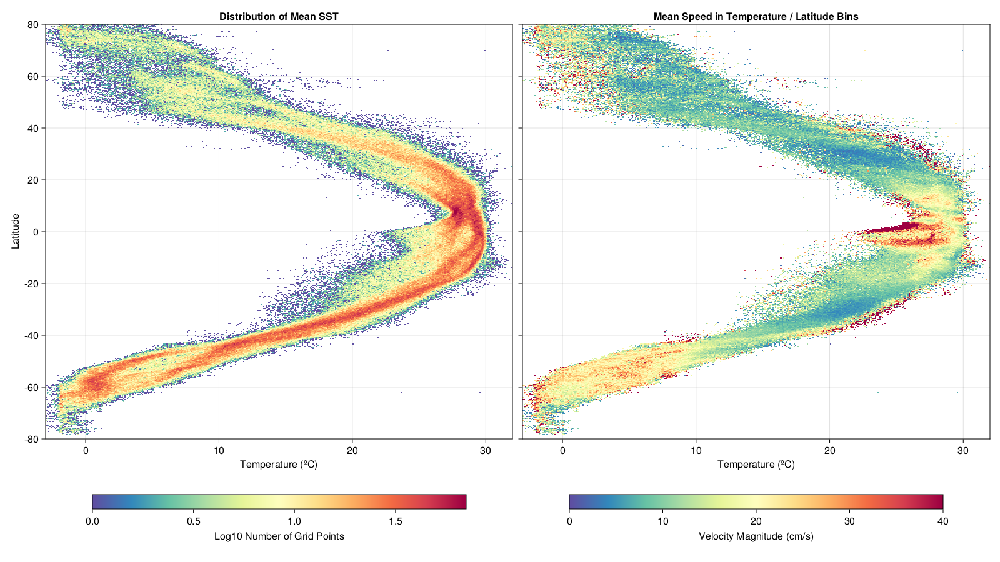

In [66]:
display(f);

The left panel again shows the distribution of grid points in bins on the latitude / mean SST plane, while the 
right panel shows the mean temperature in bins on that same plane. 

Note that the at midlatitudes, the warmest grid points&mdash;those on the far right-hand edge of the distribution&mdash;occur in the fastest currents.  These are the strong, but spatially compact western boundary currents advecting warmer water poleward.

Finally, we can use this same approach to look at the annual cycle.  We will now examine the mean current speed, and mean temperature, in bins on the latitude / day of year plane, as well as the mean values of their deviations from the zonal average. 

In [67]:
#annual cycle of current speed
set_theme!(lattwopaneltheme);f = Figure(;resolution=(1600,900),backgroundcolor)
xedges=(0:5:365);yedges=latedges

mat=nanbinmean(dayofyear.(tim),lat,abs.(u.+im.*v),xedges,yedges)
ax = Axis(f[1, 1],xticks=(0:30:360))
hm=heatmap!(mid(xedges),mid(yedges),mat',colorrange=(5,60))
ax.title="Current Speed Annual Cycle";
ax.xlabel="Yearday"
ax.ylabel="Latitude"
Colorbar(f[2,1],hm;label = "Velocity (cm/s)")

ax = Axis(f[1, 2],xticks=(0:30:360),yticklabelsvisible=false)
ax.title="Zonal Deviation of Current Speed Annual Cycle";
ax.xlabel="Yearday";
mato=nanbinmean(lon,lat,abs.(u.+im.*v),lonedges,latedges)
hm=heatmap!(mid(xedges),mid(yedges),mat'-repeat(nanmean(mato;dims=2),1,size(mat,2))',colorrange=(-12,12))
Colorbar(f[2,2],hm;label = "Velocity (cm/s)")

colgap!(f.layout,10);rowsize!(f.layout,2,Relative(0.08));

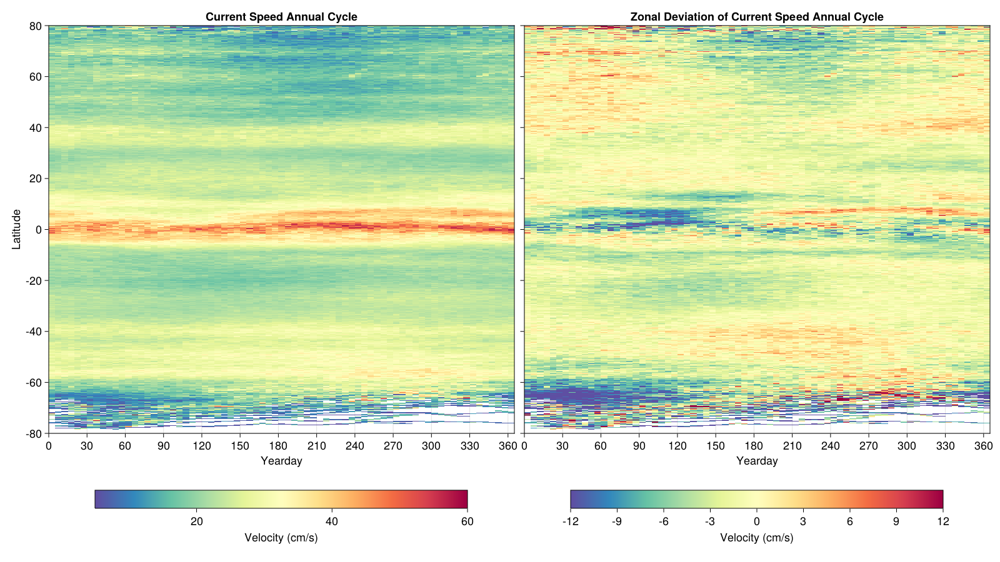

In [68]:
display(f);#highest velocity variance in a latitude band occurs where temperature variance is highest

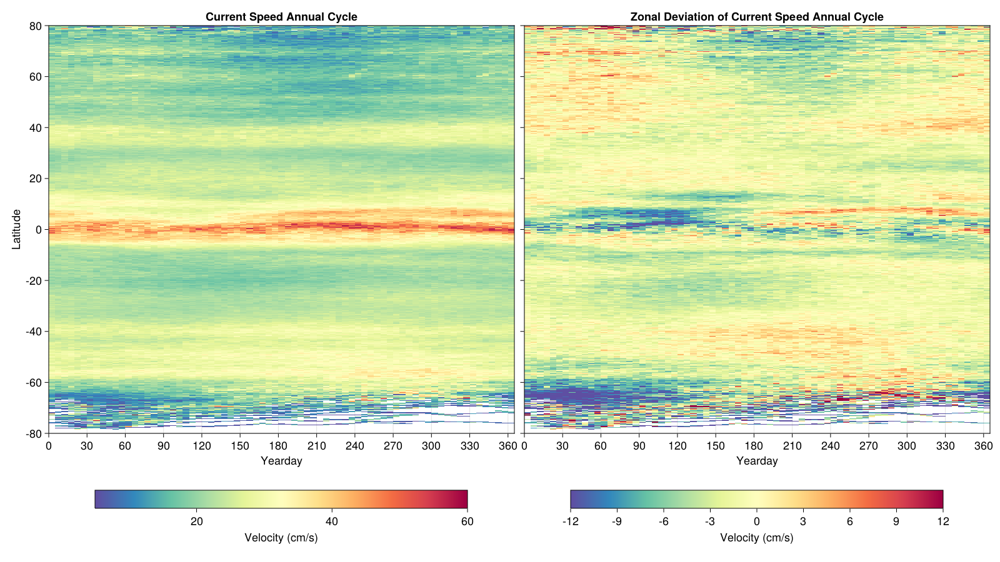

In [69]:
display(f);

In [70]:
#annual cycle of temperature
set_theme!(lattwopaneltheme);f = Figure(;resolution=(1600,900),backgroundcolor)
xedges=(0:5:365)
mat=nanbinmean(dayofyear.(tim),lat,sst,xedges,latedges)
ax = Axis(f[1, 1],xticks=(0:30:360))
hm=heatmap!(mid(xedges),mid(latedges),mat',colorrange=(0,31))
ax.title="Sea Surface Temperature Annual Cycle"
ax.xlabel="Yearday"
ax.ylabel="Latitude"
Colorbar(f[2,1],hm;label = "Temperature (ºC)")

ax = Axis(f[1, 2],xticks=(0:30:360),yticklabelsvisible=false)
ax.title="SST Zonal Deviation Annual Cycle"
ax.xlabel="Yearday"
mato=nanbinmean(lon,lat,sst,lonedges,latedges)
hm=heatmap!(mid(xedges),mid(latedges),mat'-repeat(nanmean(mato;dims=2),1,size(mat,2))',colorrange=(-6,6))
Colorbar(f[2,2],hm;label = "Temperature (ºC)")

colgap!(f.layout,10);rowsize!(f.layout,2,Relative(0.08));

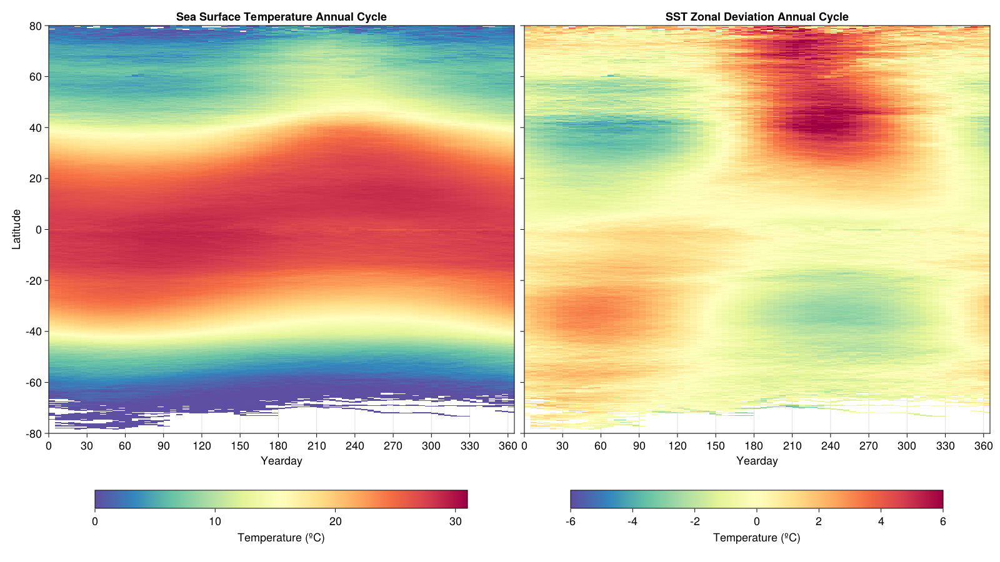

In [71]:
display(f);

From these two figures, we see that the current speed presents only a minor annual cycle, largely limited to the equatorial band, whereas the temperature unsurprisingly shows a very large annual cycle. 

This exploratory analysis has given us an overview of the main features apparent in the data.  At this point, we would begin identifying features worthy of further study and / or forming hypotheses to investigate in more detail.  

In [72]:
tock()

┌ Info:         44.620061916s: 44 seconds, 620 milliseconds
└ @ TickTock /Users/lilly/.julia/packages/TickTock/fGILW/src/TickTock.jl:62
